<a href="https://colab.research.google.com/github/mvram123/ML-and-DL-Masters-Assignments/blob/main/4Climate_Internship.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install dataprep

# Starting With Telangana 2019 WQ Datasets

1. Range of EC - 6.7 to 6320, Mean - 1537, SD - 596.61
2. EC have both Positive and negative outliers
3. Range of EC after Removing Outliers - 443 to 2035, Mean - 1392


In [ ]:
# Importing All the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


# Displaying all the rows and columns in a dataframe
pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows', None)

In [ ]:
df19 = pd.read_csv('/content/drive/MyDrive/4climate/Feature_having_morethan_700.csv')
print(df19.shape)
df19.head()

(934, 12)


,Month,Name of tank,DO (mg/L),pH,Conductivity (mS/cm),BOD (mg/L),Total coliform (MPN/100ml),Free Ammonia,Boron (mg/L),SAR,COD (mg/L),WQ
0,jan,"Mohini Cheruvu, Amberpet",3.4,7.7,1408.0,28,1825,BDL,BDL,6.7,190.0,E
1,feb,NaN,4.4,7.5,1570.0,52,2100,0.123,0.102,5.5,380.0,D
2,jan,"Langerhouse Tank - Lake, Golkonda",Nil,7.34,1342.0,14,590,NaN,0.18,2.7,85.0,E
3,mar,NaN,0.1,7.86,1446.0,24,430,NaN,0.3,3.4,98.0,E
4,apr,NaN,BDL,7.58,1490.0,22,430,NaN,0.3,2.4,92.0,E


In [ ]:
df19['Conductivity (mS/cm)'].describe()

count     920.000000
mean     1537.296446
std       596.614061
min         6.740000
25%      1209.250000
50%      1472.500000
75%      1762.000000
max      6320.000000
Name: Conductivity (mS/cm), dtype: float64

In [ ]:
from dataprep.eda import create_report

NumExpr defaulting to 2 threads.


Telangana 2019 WQ Data
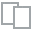
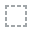
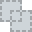
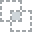
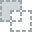
...
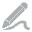
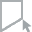
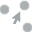
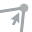
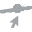

In [ ]:
create_report(df19, title='Telangana 2019 WQ Data')

## Removing Outliers

In [ ]:
df19['Conductivity (mS/cm)'].describe()

count     920.000000
mean     1537.296446
std       596.614061
min         6.740000
25%      1209.250000
50%      1472.500000
75%      1762.000000
max      6320.000000
Name: Conductivity (mS/cm), dtype: float64

In [ ]:
IQR = df19['Conductivity (mS/cm)'].describe()[6] - df19['Conductivity (mS/cm)'].describe()[4]
IQR

552.75

In [ ]:
LB = df19['Conductivity (mS/cm)'].describe()[4] - (1.5 * IQR)
UB = df19['Conductivity (mS/cm)'].describe()[4] + (1.5 * IQR)
print(LB, UB)

380.125 2038.375


In [ ]:
df19_1 = df19[df19['Conductivity (mS/cm)'] > LB ]

In [ ]:
df19_2 = df19_1[df19_1['Conductivity (mS/cm)'] < UB ]

In [ ]:
print(df19_2.shape)
df19_2.head()

(784, 12)


,Month,Name of tank,DO (mg/L),pH,Conductivity (mS/cm),BOD (mg/L),Total coliform (MPN/100ml),Free Ammonia,Boron (mg/L),SAR,COD (mg/L),WQ
0,jan,"Mohini Cheruvu, Amberpet",3.4,7.7,1408.0,28,1825,BDL,BDL,6.7,190.0,E
1,feb,NaN,4.4,7.5,1570.0,52,2100,0.123,0.102,5.5,380.0,D
2,jan,"Langerhouse Tank - Lake, Golkonda",Nil,7.34,1342.0,14,590,NaN,0.18,2.7,85.0,E
3,mar,NaN,0.1,7.86,1446.0,24,430,NaN,0.3,3.4,98.0,E
4,apr,NaN,BDL,7.58,1490.0,22,430,NaN,0.3,2.4,92.0,E


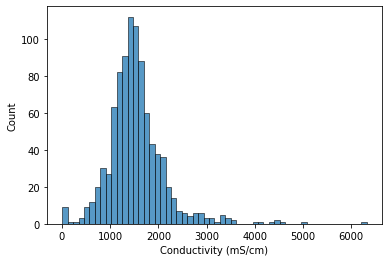

In [ ]:
# Initial Conductivity
sns.histplot(df19['Conductivity (mS/cm)'])

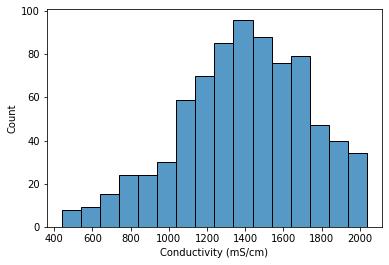

In [ ]:
sns.histplot(df19_2['Conductivity (mS/cm)'])

In [ ]:
df19_2['Conductivity (mS/cm)'].describe()

count     784.000000
mean     1392.330357
std       334.378395
min       443.000000
25%      1172.750000
50%      1409.500000
75%      1638.000000
max      2035.000000
Name: Conductivity (mS/cm), dtype: float64

# Telangana 2020 Dataset
1. Range of EC - 119 to 3270
2. EC Have positive outliers
3. Range after Removing Outliers - 119 to 1793, Mean - 1103

In [ ]:
df20 = pd.read_csv('/content/drive/MyDrive/4climate/Telangana_2020.csv')
print(df20.shape)
df20.head()

(1079, 10)


,Name of tank,DO (mg/L),pH,Conductivity (mS/cm),BOD (mg/L),Total coliform (MPN/100ml),Free Ammonia,Boron (mg/L),SAR,Month
0,"Mohini Cheruvu , Amberpet , Amberpet , HYD",5.4,8.80,1078.0,11.0,540,0.15,<0.01,3.4,January
1,"Naya Quila Talab , Golkonda , Golkonda , HYD",4.3,8.74,1239.0,8.0,240,0.14,<0.01,2.7,January
2,"Yerra Kunta , Shaikpet , Shaikpet , HYD",3.1,7.64,1028.0,32.0,540,0.38,<0.01,2.5,January
3,"Kotha Cheruvu , Shaikpet , Shaikpet , HYD",5.6,8.44,963.0,5.0,240,<0.01,<0.01,2.0,January
4,"Shikari Kunta , Hakimpet , Shaikpet , HYD",5.2,8.43,1100.0,6.0,130,<0.01,<0.01,2.1,January


In [ ]:
df20['Conductivity (mS/cm)'].describe()

count    1068.000000
mean     1216.062734
std       490.858291
min       119.000000
25%       895.000000
50%      1194.500000
75%      1498.000000
max      3270.000000
Name: Conductivity (mS/cm), dtype: float64

In [ ]:
df20['Conductivity (mS/cm)'].median()

1194.5

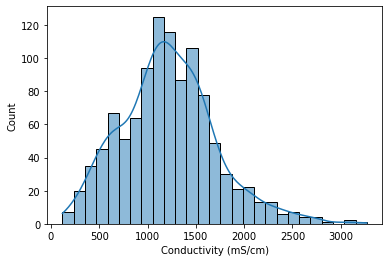

In [ ]:
sns.histplot(df20['Conductivity (mS/cm)'], kde=True)

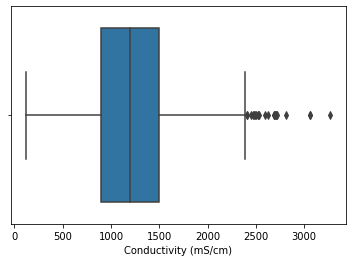

In [ ]:
sns.boxplot(df20['Conductivity (mS/cm)'])

In [ ]:
IQR = df20['Conductivity (mS/cm)'].describe()[6] - df20['Conductivity (mS/cm)'].describe()[4]
IQR

603.0

In [ ]:
LB = df20['Conductivity (mS/cm)'].describe()[4] - (1.5 * IQR)
UB = df20['Conductivity (mS/cm)'].describe()[4] + (1.5 * IQR)
print(LB, UB)

-9.5 1799.5


In [ ]:
df20_1 = df20[df20['Conductivity (mS/cm)'] > LB ]

In [ ]:
df20_2 = df20_1[df20_1['Conductivity (mS/cm)'] < UB ]

In [ ]:
print(df20_2.shape)
df20_2.head()

(953, 10)


,Name of tank,DO (mg/L),pH,Conductivity (mS/cm),BOD (mg/L),Total coliform (MPN/100ml),Free Ammonia,Boron (mg/L),SAR,Month
0,"Mohini Cheruvu , Amberpet , Amberpet , HYD",5.4,8.80,1078.0,11.0,540,0.15,<0.01,3.4,January
1,"Naya Quila Talab , Golkonda , Golkonda , HYD",4.3,8.74,1239.0,8.0,240,0.14,<0.01,2.7,January
2,"Yerra Kunta , Shaikpet , Shaikpet , HYD",3.1,7.64,1028.0,32.0,540,0.38,<0.01,2.5,January
3,"Kotha Cheruvu , Shaikpet , Shaikpet , HYD",5.6,8.44,963.0,5.0,240,<0.01,<0.01,2.0,January
4,"Shikari Kunta , Hakimpet , Shaikpet , HYD",5.2,8.43,1100.0,6.0,130,<0.01,<0.01,2.1,January


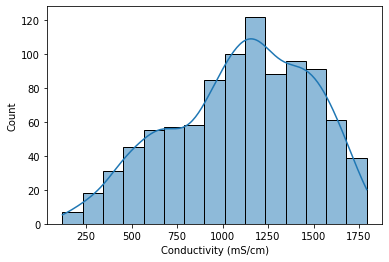

In [ ]:
sns.histplot(df20_2['Conductivity (mS/cm)'], kde=True)

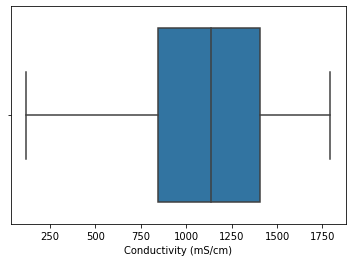

In [ ]:
sns.boxplot(df20_2['Conductivity (mS/cm)'])

In [ ]:
df20_2.describe()

,pH,Conductivity (mS/cm),BOD (mg/L),SAR
count,953.000000,953.000000,953.000000,953.000000
mean,7.411343,1103.675761,14.542812,2.847801
std,0.468920,376.044842,13.603491,2.581440
min,0.500000,119.000000,1.800000,0.000000
25%,7.140000,844.000000,6.000000,1.510000
50%,7.370000,1139.000000,12.000000,2.421768
75%,7.660000,1408.000000,18.000000,3.742562
max,9.400000,1793.000000,144.000000,49.000000


# Telangana 2021 Dataset
1. Range of Ec -  23 to 3410
2. Has both positive and negative outliers
3. Range after removing outliers - 23 to 1852, Mean- 1142

In [ ]:
df21 = pd.read_csv('/content/drive/MyDrive/4climate/Telangana_2021.csv')
print(df21.shape)
df21.head()

(334, 10)


,Name of tank,DO,pH,Conductivity (mS/cm),BOD (mg/L),Total coliform (MPN/100ml),Free Ammonia,Boron (mg/L),SAR,Month
0,"Jamal Kunta , Shaikpet , Shaikpet , HYD",5.2,7.57,1810.0,40.0,320,0.02,0.1,3.1,January
1,"Kotha Kunta , Hakimpet , Shaikpet , HYD",5.8,7.49,1170.0,7.0,79,0.01,0.1,2.22,January
2,"Gurram Cheruvu , Kandikal (Barkas) , Bandlagud...",4.0,7.42,1540.0,23.0,33,0.035,0.1,1.6,January
3,"Chinna Cheruvu , Ramanthapur , Uppal , Medchal...",0.3,7.82,1280.0,10.0,430,0.02,0.1,1.7270543466191428,January
4,"Kamuni Cheru , Moosapet , Balanagar , Medchal-...",4.2,7.52,1295.0,16.0,1600,0.03,0.1,2.6,January


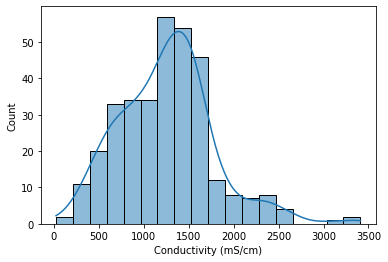

In [ ]:
sns.histplot(df21['Conductivity (mS/cm)'], kde=True)

In [ ]:
df21['Conductivity (mS/cm)'].describe()

count     333.000000
mean     1252.756757
std       529.566432
min        23.000000
25%       890.000000
50%      1265.000000
75%      1544.000000
max      3410.000000
Name: Conductivity (mS/cm), dtype: float64

In [ ]:
IQR = df21['Conductivity (mS/cm)'].describe()[6] - df21['Conductivity (mS/cm)'].describe()[4]
IQR

654.0

In [ ]:
LB = df21['Conductivity (mS/cm)'].describe()[4] - (1.5 * IQR)
UB = df21['Conductivity (mS/cm)'].describe()[4] + (1.5 * IQR)
print(LB, UB)

-91.0 1871.0


In [ ]:
df21_1 = df21[df21['Conductivity (mS/cm)'] > LB ]

In [ ]:
df21_2 = df21_1[df21_1['Conductivity (mS/cm)'] < UB ]

In [ ]:
print(df21_2.shape)
df21_2.head()

(302, 10)


,Name of tank,DO,pH,Conductivity (mS/cm),BOD (mg/L),Total coliform (MPN/100ml),Free Ammonia,Boron (mg/L),SAR,Month
0,"Jamal Kunta , Shaikpet , Shaikpet , HYD",5.2,7.57,1810.0,40.0,320,0.02,0.1,3.1,January
1,"Kotha Kunta , Hakimpet , Shaikpet , HYD",5.8,7.49,1170.0,7.0,79,0.01,0.1,2.22,January
2,"Gurram Cheruvu , Kandikal (Barkas) , Bandlagud...",4.0,7.42,1540.0,23.0,33,0.035,0.1,1.6,January
3,"Chinna Cheruvu , Ramanthapur , Uppal , Medchal...",0.3,7.82,1280.0,10.0,430,0.02,0.1,1.7270543466191428,January
4,"Kamuni Cheru , Moosapet , Balanagar , Medchal-...",4.2,7.52,1295.0,16.0,1600,0.03,0.1,2.6,January


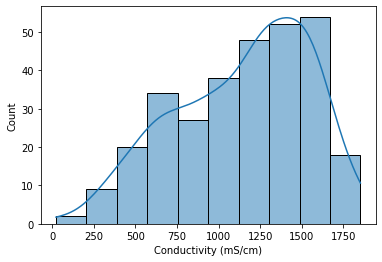

In [ ]:
sns.histplot(df21_2['Conductivity (mS/cm)'], kde=True)

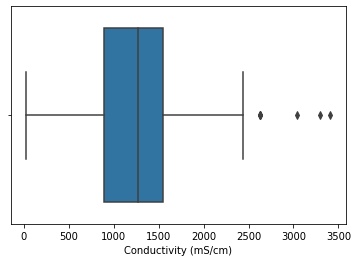

In [ ]:
sns.boxplot(df21['Conductivity (mS/cm)'])

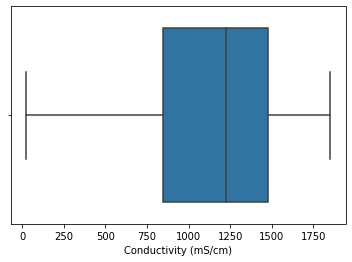

In [ ]:
sns.boxplot(df21_2['Conductivity (mS/cm)'])

In [ ]:
df21_2.describe()

,DO,pH,Conductivity (mS/cm),BOD (mg/L),Boron (mg/L)
count,302.000000,302.000000,302.000000,302.000000,302.000000
mean,2.360596,7.459205,1142.000000,8.568874,0.151119
std,2.026110,0.338751,402.677451,7.260018,0.135226
min,0.300000,6.650000,23.000000,1.600000,0.020000
25%,0.300000,7.200000,845.000000,4.000000,0.100000
50%,2.100000,7.435000,1228.000000,7.000000,0.100000
75%,3.875000,7.697500,1480.000000,10.000000,0.100000
max,7.300000,8.610000,1852.000000,76.000000,0.800000


# Sensor data 30 CM

In [ ]:
sd = pd.read_excel('/content/drive/MyDrive/4climate/Sensor data for 30 cm.xlsx')
print(sd.shape)
sd.head()

(9623, 4)


,Date and Time,Temperature (°C),pH,Turbidity (NTU)
0,2020-01-15 16:00:35,20.99,7.81,197
1,2020-01-15 16:01:33,20.99,7.81,197
2,2020-01-15 16:02:33,20.98,7.81,197
3,2020-01-15 16:03:22,20.98,7.81,197
4,2020-01-15 16:04:26,20.98,7.81,197


In [ ]:
sd['Date and Time'] = sd['Date and Time'].apply(lambda x: x.split())

In [ ]:
sd['Date'] = sd['Date and Time'].apply(lambda x: x[0])
sd['Time'] = sd['Date and Time'].apply(lambda x: x[1])

In [ ]:
sd = sd.drop('Date and Time', axis=1)

In [ ]:
sd = sd[['Date', 'Time', 'Temperature (°C) ', 'pH', 'Turbidity (NTU)']]

In [ ]:
print(sd.shape)
sd.head()

(9623, 5)


,Date,Time,Temperature (°C),pH,Turbidity (NTU)
0,2020-01-15,16:00:35,20.99,7.81,197
1,2020-01-15,16:01:33,20.99,7.81,197
2,2020-01-15,16:02:33,20.98,7.81,197
3,2020-01-15,16:03:22,20.98,7.81,197
4,2020-01-15,16:04:26,20.98,7.81,197


In [ ]:
sd['Date'].unique()

array(['2020-01-15', '2020-01-16', '2020-01-17', '2020-01-18',
       '2020-01-19', '2020-01-20', '2020-01-21', '2020-01-22'],
      dtype=object)


### Important Points 

- On Day I am Keeping 1212 and on nigth 1175
- 6th day -  20th Jan - It is a Rainy Day
- Water temperature can cause conductivity levels to fluctuate daily.
- body of water warms up due to sunlight, (and conductivity increases) and then cools down at night (decreasing conductivity).
- For every 1°C increase, conductivity values can increase 2-4%
- Rain itself can have a higher conductivity than pure water due to the incorporation of gases and dust particles.

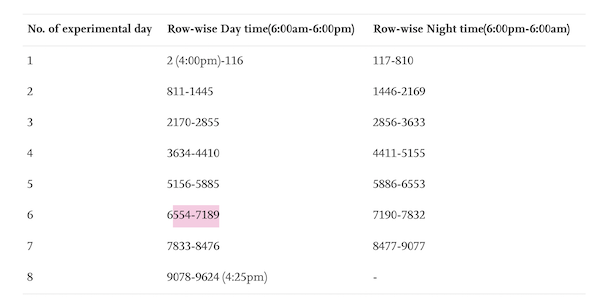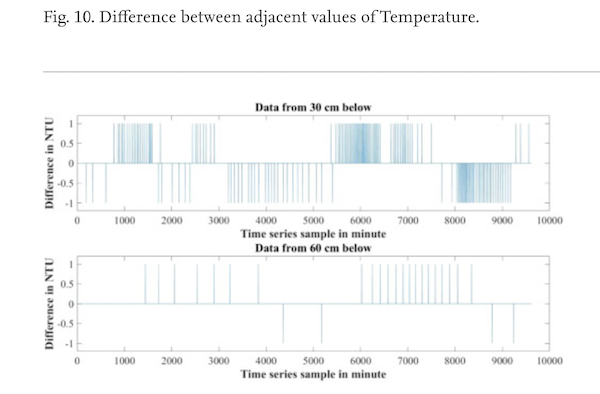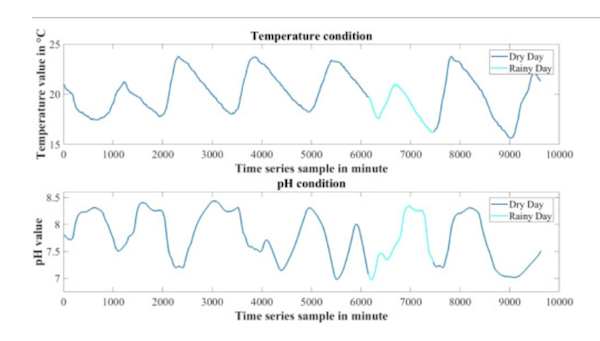

**Assuming for 20.99°C, The EC value is 850.33**


In [ ]:
value = 22.99
init = 850.33
# The values in per are 2,3 and 4 percent of Init value
per = [17, 25.5, 34.01] 
def ec(x):
  a = x - value
  v = init + (per[np.random.randint(0,3,1)[0]] * a) # Randomly Assigning 2, 3 and 4 %
  return v

In [ ]:
sd['Conductivity (μS/cm)'] = sd['Temperature (°C) '].apply(lambda x: ec(x))

In [ ]:
sd.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
0,2020-01-15,16:00:35,20.99,7.81,197,782.3100
1,2020-01-15,16:01:33,20.99,7.81,197,799.3300
2,2020-01-15,16:02:33,20.98,7.81,197,781.9699
3,2020-01-15,16:03:22,20.98,7.81,197,816.1600
4,2020-01-15,16:04:26,20.98,7.81,197,799.0750


In [ ]:
sd['Date'].unique()

array(['2020-01-15', '2020-01-16', '2020-01-17', '2020-01-18',
       '2020-01-19', '2020-01-20', '2020-01-21', '2020-01-22'],
      dtype=object)

In [ ]:
# Creating New DF For Rainy Day
rain = sd.copy()
rain = sd[sd['Date'] == '2020-01-20']

In [ ]:
print(rain.shape)
rain.head()

(1282, 6)


,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
6228,2020-01-20,00:00:10,18.81,6.99,226,743.7400
6229,2020-01-20,00:01:10,18.81,6.99,226,708.1682
6230,2020-01-20,00:02:11,18.78,7.00,226,707.1479
6231,2020-01-20,00:03:11,18.77,7.00,226,742.7200
6232,2020-01-20,00:04:11,18.75,7.00,226,778.2500


In [ ]:
# In rainy day, EC will increase
# Here Init value is increased to around 100

value = 19.44
init = 750.33
per = [15, 22.50, 30.01] # 2,3 and 4 %
def ec(x):
  a = x - value
  v = init + (per[np.random.randint(0,3,1)[0]] * a)
  return v

In [ ]:
rain['Conductivity (μS/cm)'] = rain['Temperature (°C) '].apply(lambda x: ec(x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
print(rain.shape)
rain.tail()

(1282, 6)


,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
7505,2020-01-20,23:55:22,16.51,7.22,249,684.4050
7506,2020-01-20,23:56:29,16.49,7.22,249,661.8005
7507,2020-01-20,23:57:36,16.51,7.22,249,662.4007
7508,2020-01-20,23:58:43,16.51,7.22,249,706.3800
7509,2020-01-20,23:59:50,16.51,7.22,249,706.3800


In [ ]:
sd[sd['Date'] == '2020-01-20'] = rain

In [ ]:
sd.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
0,2020-01-15,16:00:35,20.99,7.81,197,782.3100
1,2020-01-15,16:01:33,20.99,7.81,197,799.3300
2,2020-01-15,16:02:33,20.98,7.81,197,781.9699
3,2020-01-15,16:03:22,20.98,7.81,197,816.1600
4,2020-01-15,16:04:26,20.98,7.81,197,799.0750


In [ ]:
# night time
init = [712.24, 698.56, 680.47, 720.68, 731.42, 705.12, 690.72]
import numpy as np
k = np.mean(init)
per_new = [k/100 * i for i in range(2,5)]

In [ ]:
k

705.6014285714285

In [ ]:
# Updated % values
per_new

[14.11202857142857, 21.168042857142858, 28.22405714285714]

In [ ]:
# During Night Time
# Here Init value is increased to around 100
value = 19.8
# 2,3 and 4 %
def ec(x):
  a = x - value
  v = (init[np.random.randint(0,7,1)[0]]) + (per_new[np.random.randint(0,3,1)[0]] * a)
  return v

In [ ]:
night = sd.copy()
night_ranges = [(117, 810),(2856, 3633), (4411, 5155), (5886, 6227), (8477, 9077)]
for i in night_ranges:
  night = sd.iloc[i[0]:i[1]]
  night['Conductivity (μS/cm)'] = night['Temperature (°C) '].apply(lambda x: ec(x))
  sd.iloc[i[0]:i[1]] = night

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [ ]:
print(sd.shape)
sd.head()

(9623, 6)


,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
0,2020-01-15,16:00:35,20.99,7.81,197,782.3100
1,2020-01-15,16:01:33,20.99,7.81,197,799.3300
2,2020-01-15,16:02:33,20.98,7.81,197,781.9699
3,2020-01-15,16:03:22,20.98,7.81,197,816.1600
4,2020-01-15,16:04:26,20.98,7.81,197,799.0750


In [ ]:
print(sd.iloc[117:814].shape)
sd.iloc[117:814].head()

(697, 6)


,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
117,2020-01-15,18:03:25,20.27,7.72,197,693.735307
118,2020-01-15,18:04:22,20.26,7.72,197,737.911533
119,2020-01-15,18:05:20,20.27,7.72,197,727.312653
120,2020-01-15,18:06:15,20.28,7.72,197,697.493774
121,2020-01-15,18:08:05,20.26,7.72,197,690.207300


In [ ]:
sd.iloc[110:814].head(10)

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
110,2020-01-15,17:55:58,20.38,7.73,197,783.775000
111,2020-01-15,17:56:53,20.36,7.73,197,805.620000
112,2020-01-15,17:57:55,20.33,7.72,197,782.500000
113,2020-01-15,17:58:50,20.30,7.72,197,758.843100
114,2020-01-15,17:59:45,20.31,7.72,197,781.990000
115,2020-01-15,18:00:43,20.31,7.72,197,804.770000
116,2020-01-15,18:02:29,20.29,7.72,197,781.480000
117,2020-01-15,18:03:25,20.27,7.72,197,693.735307
118,2020-01-15,18:04:22,20.26,7.72,197,737.911533
119,2020-01-15,18:05:20,20.27,7.72,197,727.312653


### Mapping Turbidity Values to 6 to 24 NTU
-  I am using np.interp(value, given_range, wanted_range)
- given range : 194 to 249
- wanted range : 6 to 24

In [ ]:
sd['Turbidity (NTU)'].describe()

count    9623.000000
mean      215.485192
std        16.179374
min       194.000000
25%       202.000000
50%       212.000000
75%       224.000000
max       249.000000
Name: Turbidity (NTU), dtype: float64

In [ ]:
np.interp(248,[194,249],[6,24])

23.672727272727272

In [ ]:
sd['Turbidity (NTU)'] = sd['Turbidity (NTU)'].apply(lambda x: np.interp(x, [194,249], [6,24]))

In [ ]:
sd.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750


### TDS Formula 

TDS (ppm) = Conductivity(μs/cm) * Factor (generally use 0.67) -> Formula Doubt

- The Unit we used for Conductivity is millisiemens per centimeter (ms/cm)
- **1 millisiemens/centimeter = 1000 microsiemens/centimeter (μs/cm)**

In [ ]:
sd['Random'] = sd['Temperature (°C) '].apply(lambda x: 1 / (1 + 0.019 * x))

In [ ]:
sd['k 25'] = sd['Conductivity (μS/cm)'] * sd['Random']

In [ ]:
sd.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),Random,k 25
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,0.714893,559.268235
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,0.714893,571.435720
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,0.714990,559.101042
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,0.714990,583.546639
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,0.714990,571.331026


In [ ]:
sd['TDS (ppm)'] = sd['k 25'].apply(lambda x: (x) * (0.67))

In [ ]:
sd.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),Random,k 25,TDS (ppm)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,0.714893,559.268235,374.709718
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,0.714893,571.435720,382.861933
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,0.714990,559.101042,374.597698
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,0.714990,583.546639,390.976248
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,0.714990,571.331026,382.791788


### Salinity 
- Salinity(ppt) = (Conductivity(μs/cm)/1000) ^ 1.09 * 0.47


In [ ]:
a1 = 4.98e-1
a2 = 9.54e-3
a3 = -3.941e-4
a4 = 1.092e-5
a5 = -1.559e-7
a6 = 8.789e-10

In [ ]:
#sd['Salinity (ppt)'] = sd['k 25'].apply(lambda x: (a1*(x) + a2*(x**2)+ a3*(x**3)+ a4*(x**4)+ a5*(x**5)+ a6*(x**6)))
sd['Salinity (ppt)'] = sd['k 25'].apply(lambda x: ((x/1000)**1.09)*0.47)

In [ ]:
sd.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),Random,k 25,TDS (ppm),Salinity (ppt)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,0.714893,559.268235,374.709718,0.249462
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,0.714893,571.435720,382.861933,0.255383
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,0.714990,559.101042,374.597698,0.249380
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,0.714990,583.546639,390.976248,0.261288
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,0.714990,571.331026,382.791788,0.255332


### Chloride
Chloride(ppm) = Salinity(ppt) * Factor(569)

In [ ]:
sd['Chloride (ppm)'] = sd['Salinity (ppt)'].apply(lambda x: x * 569)

In [ ]:
print(sd.shape)
sd.head()

(9623, 11)


,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),Random,k 25,TDS (ppm),Salinity (ppt),Chloride (ppm)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,0.714893,559.268235,374.709718,0.249462,141.943690
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,0.714893,571.435720,382.861933,0.255383,145.313035
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,0.714990,559.101042,374.597698,0.249380,141.897438
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,0.714990,583.546639,390.976248,0.261288,148.673134
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,0.714990,571.331026,382.791788,0.255332,145.284016


### Dissolved Oxygen
- Study of seasonal water quality assessment and **fish pond** conservation Tamilnadu --> **6.5 to 7.9 mg/L**
- Water quality assessment of capture and culture **fisheries** Assam, India --> **3 to 5 mg/L** (Suitable for fish but the growth is slow)
- Study of Physico-Chemical Parameters and Pond Water Quality Assessment by using WQI Kerala, India --> 1.76 – 8.4 mg/l
- Water quality guidelines for the management of **pond fish** culture kurushetra --> **above 5 mg/L** is optimum
- **The fish Site** --> **above 4 mg/L**


### Ammonia
-  **The fish Site** --> **0 to 0.5 ppm**
- Water quality guidelines for the management of **pond fish** culture kurushetra

- The toxic levels for un-ionized ammonia for short-term exposure usually lie between 0.6 and 2.0 mg L-1 for pond fish, and sublethal effects may occur at 0.1 to 0.3 mg L-1 (EIFAC, 1973; Robinette, 1976). Maximum limit of ammonia concentration for aquatic organisms is 0.1 mg L-1(Meade, 1985: Santhosh and Singh, 2007). According to Swann (1997) and OATA (2008) the levels below 0.02 ppm were considered safe. 

- Stone and Thomforde (2004) stated the desirable range as Total NH3-N: 0-2 mg L-1 and Un-ionized NH3-N: 0 mg L-1 and acceptable range as **Total NH3-N: Less than 4 mg L-1 and Un-ionized NH3-N: Less than 0.4 mg L-1**.Bhatnagar et al. (2004) suggested 0.01-0.5 ppm is desirable for shrimp; >0.4 ppm is lethal to
many fishes & prawn species; 0.05-0.4 ppm has sublethal effect and <0.05 ppm is safe for many tropical fish species and prawns. 
- Bhatnagar and Singh (2010) recommended the level of ammonia (<0.2 mg L-1) suitable for pond fishery.

In [ ]:
# Dissolved Oxygen
# taking 6.5 to 7.9 mg/L as range: Mean -> 7.2, Values -> 7.2 +- 0.7
change = list(np.arange(-0.7, 0,0.1)) + list(np.arange(0, 0.8, 0.1))
change1 = list(np.arange(0.01, 0.10, 0.01))
change2 = list(np.arange(0.001, 0.010, 0.001))
Init = 7.2 
def do(x):
  v = Init + change[np.random.randint(0, 14, 1)[0]] + change1[np.random.randint(0, 9, 1)[0]] 
  return v

In [ ]:
sd['DO (mg/L)'] = sd['Conductivity (μS/cm)'].apply(lambda x: do(x))

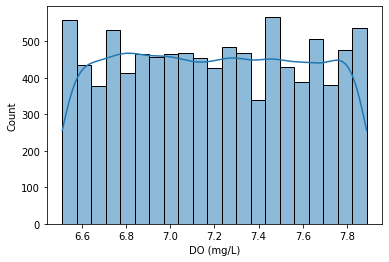

In [ ]:
sns.histplot(sd['DO (mg/L)'],kde=True)

In [ ]:
# Ammonia
base = 0.3 
change = list(np.arange(0.01, 0.10, 0.01))
change1 = list(np.arange(0.001, 0.010, 0.001))
def ammonia(x):
  v = base + change[np.random.randint(0, 9, 1)[0]] + change1[np.random.randint(0, 9, 1)[0]]
  return v

In [ ]:
sd['Ammonia (ppm)'] = sd['Conductivity (μS/cm)'].apply(lambda x: ammonia(x))

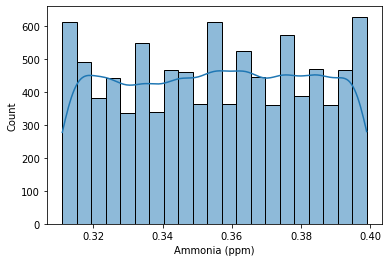

In [ ]:
sns.histplot(sd['Ammonia (ppm)'],kde=True)

In [ ]:
sd = sd.drop(['Random', 'k 25'],axis=1)

Sensor Data Basic Features Updated
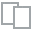
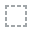
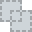
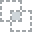
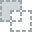
...
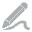
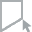
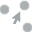
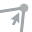
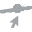

In [ ]:
from dataprep.eda import create_report
create_report(sd,title='Sensor Data Basic Features Updated')

In [ ]:
sd.head(10)

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,374.709718,0.249462,141.943690,6.57,0.369
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,382.861933,0.255383,145.313035,7.37,0.381
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,374.597698,0.249380,141.897438,7.38,0.383
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,390.976248,0.261288,148.673134,7.33,0.317
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,382.791788,0.255332,145.284016,7.31,0.385
5,2020-01-15,16:05:21,20.97,7.81,6.981818,781.6298,374.485649,0.249299,141.851174,6.63,0.357
6,2020-01-15,16:06:20,20.97,7.81,6.981818,798.8200,382.721624,0.255281,145.254990,7.71,0.343
7,2020-01-15,16:07:17,20.95,7.81,6.981818,815.6500,390.891241,0.261227,148.637901,7.81,0.379
8,2020-01-15,16:08:59,20.94,7.81,6.981818,798.0550,382.511017,0.255128,145.167866,7.07,0.364
9,2020-01-15,16:10:00,20.93,7.81,6.981818,815.3100,390.834532,0.261185,148.614396,6.89,0.316


In [ ]:
data = sd.copy()

In [ ]:
data.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,374.709718,0.249462,141.943690,6.57,0.369
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,382.861933,0.255383,145.313035,7.37,0.381
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,374.597698,0.249380,141.897438,7.38,0.383
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,390.976248,0.261288,148.673134,7.33,0.317
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,382.791788,0.255332,145.284016,7.31,0.385


# BIS Standards
1. Temperatue - 26.5
1. pH - **6.5 to 8.5**
2. Turbidity - **1 NTU Max** - **5 NTU Permissible**
3. Conductivity - 300 μs/cm From Research Paper
4. TDS - **500 ppm Max** - 2000 ppm Permissible
5. Salinity - 0.3 ppt  - I will try 4 ppt
6. Chloride - **250 ppm Max** - 1000 ppm permissible
8. DO. - **5 mg/L** 
9. Ammonia - **0.5 mg/L Max**



In [ ]:
data.columns

Index(['Date', 'Time', 'Temperature (°C) ', 'pH', 'Turbidity (NTU)',
       'Conductivity (μS/cm)', 'TDS (ppm)', 'Salinity (ppt)', 'Chloride (ppm)',
       'DO (mg/L)', 'Ammonia (ppm)'],
      dtype='object')

In [ ]:
data.head(20)

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm)
0,2020-01-15,16:00:35,20.99,7.81,6.981818,782.3100,374.709718,0.249462,141.943690,6.57,0.369
1,2020-01-15,16:01:33,20.99,7.81,6.981818,799.3300,382.861933,0.255383,145.313035,7.37,0.381
2,2020-01-15,16:02:33,20.98,7.81,6.981818,781.9699,374.597698,0.249380,141.897438,7.38,0.383
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.1600,390.976248,0.261288,148.673134,7.33,0.317
4,2020-01-15,16:04:26,20.98,7.81,6.981818,799.0750,382.791788,0.255332,145.284016,7.31,0.385
5,2020-01-15,16:05:21,20.97,7.81,6.981818,781.6298,374.485649,0.249299,141.851174,6.63,0.357
6,2020-01-15,16:06:20,20.97,7.81,6.981818,798.8200,382.721624,0.255281,145.254990,7.71,0.343
7,2020-01-15,16:07:17,20.95,7.81,6.981818,815.6500,390.891241,0.261227,148.637901,7.81,0.379
8,2020-01-15,16:08:59,20.94,7.81,6.981818,798.0550,382.511017,0.255128,145.167866,7.07,0.364
9,2020-01-15,16:10:00,20.93,7.81,6.981818,815.3100,390.834532,0.261185,148.614396,6.89,0.316


In [ ]:
BIS_standards = [26.5, 8.5, 5, 300, 500, 0.3, 250, 5, 0.5]

In [ ]:
sum = 0
for i in BIS_standards:
  sum = sum + (1/i)
k = 1 / sum

In [ ]:
k, sum

(0.1695475745601611, 5.8980495745468)

In [ ]:
unit_weights = map(lambda x: k/x, BIS_standards)

In [ ]:
# Unit Weights
u_weights = list(unit_weights)
u_weights

[0.006398021681515513,
 0.019946773477666012,
 0.033909514912032215,
 0.0005651585818672037,
 0.0003390951491203222,
 0.5651585818672037,
 0.0006781902982406444,
 0.033909514912032215,
 0.3390951491203222]

In [ ]:
# Ideal Values
ideal = [0,7, 0, 0, 0, 0, 0, 14.6, 0]

In [ ]:
data['pH Vn/sn'] = data['pH'].apply(lambda x: (x-7)* 100/1.5)

In [ ]:
data['DO Vn/sn'] = data['DO (mg/L)'].apply(lambda x: (x - 14.6)/(5 - 14.6))

In [ ]:
data.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),pH Vn/sn,DO Vn/sn
0,2020-01-15,16:00:35,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,54.0,0.763542
1,2020-01-15,16:01:33,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,54.0,0.830208
2,2020-01-15,16:02:33,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,54.0,0.740625
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,54.0,0.767708
4,2020-01-15,16:04:26,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,54.0,0.823958


In [ ]:
data['Temperature Vn/sn'] = data['Temperature (°C) '].apply(lambda x: x/BIS_standards[0] * 100)
data['Turbidity Vn/sn'] = data['Turbidity (NTU)'].apply(lambda x: x/BIS_standards[2] * 100)
data['Conductivity Vn/sn'] = data['Conductivity (μS/cm)'].apply(lambda x: x/BIS_standards[3] * 100)
data['TDS Vn/sn'] = data['TDS (ppm)'].apply(lambda x: x/BIS_standards[4] * 100)
data['Salinity Vn/sn'] = data['Salinity (ppt)'].apply(lambda x: x/BIS_standards[5] * 100)
data['Chloride Vn/sn'] = data['Chloride (ppm)'].apply(lambda x: x/BIS_standards[6] * 100)
data['Ammonia Vn/sn'] = data['Ammonia (ppm)'].apply(lambda x: x/BIS_standards[8] * 100)

In [ ]:
data.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),pH Vn/sn,DO Vn/sn,Temperature Vn/sn,Turbidity Vn/sn,Conductivity Vn/sn,TDS Vn/sn,Salinity Vn/sn,Chloride Vn/sn,Ammonia Vn/sn
0,2020-01-15,16:00:35,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,54.0,0.763542,79.207547,139.636364,266.443333,76.572387,85.127730,58.125214,77.8
1,2020-01-15,16:01:33,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,54.0,0.830208,79.207547,139.636364,260.770000,74.941944,83.153890,56.777476,79.2
2,2020-01-15,16:02:33,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,54.0,0.740625,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,75.4
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,54.0,0.767708,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,73.2
4,2020-01-15,16:04:26,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,54.0,0.823958,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,69.0


In [ ]:
data['Temperature WnQn'] = data['Temperature Vn/sn'].apply(lambda x: x * u_weights[0])
data['pH WnQn'] = data['pH Vn/sn'].apply(lambda x: x * u_weights[1])
data['Turbidity WnQn'] = data['Turbidity Vn/sn'].apply(lambda x: x * u_weights[2])
data['Conductivity WnQn'] = data['Conductivity Vn/sn'].apply(lambda x: x * u_weights[3])
data['TDS WnQn'] = data['TDS Vn/sn'].apply(lambda x: x * u_weights[4])
data['Salinity WnQn'] = data['Salinity Vn/sn'].apply(lambda x: x * u_weights[5])
data['Chloride WnQn'] = data['Chloride Vn/sn'].apply(lambda x: x * u_weights[6])
data['DO WnQn'] = data['DO Vn/sn'].apply(lambda x: x * u_weights[7])
data['Ammonia WnQn'] = data['Ammonia Vn/sn'].apply(lambda x: x * u_weights[8])

In [ ]:
data.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),pH Vn/sn,DO Vn/sn,Temperature Vn/sn,Turbidity Vn/sn,Conductivity Vn/sn,TDS Vn/sn,Salinity Vn/sn,Chloride Vn/sn,Ammonia Vn/sn,Temperature WnQn,pH WnQn,Turbidity WnQn,Conductivity WnQn,TDS WnQn,Salinity WnQn,Chloride WnQn,DO WnQn,Ammonia WnQn
0,2020-01-15,16:00:35,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,54.0,0.763542,79.207547,139.636364,266.443333,76.572387,85.127730,58.125214,77.8,0.506772,1.077126,4.735001,0.150583,0.025965,48.110667,0.039420,0.025891,26.381603
1,2020-01-15,16:01:33,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,54.0,0.830208,79.207547,139.636364,260.770000,74.941944,83.153890,56.777476,79.2,0.506772,1.077126,4.735001,0.147376,0.025412,46.995135,0.038506,0.028152,26.856336
2,2020-01-15,16:02:33,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,54.0,0.740625,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,75.4,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.025114,25.567774
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,54.0,0.767708,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,73.2,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.026033,24.821765
4,2020-01-15,16:04:26,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,54.0,0.823958,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,69.0,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.027940,23.397565


In [ ]:
data[['Temperature WnQn','pH WnQn','Turbidity WnQn','Conductivity WnQn','TDS WnQn','Salinity WnQn','Chloride WnQn','DO WnQn', 'Ammonia WnQn']].head()

,Temperature WnQn,pH WnQn,Turbidity WnQn,Conductivity WnQn,TDS WnQn,Salinity WnQn,Chloride WnQn,DO WnQn,Ammonia WnQn
0,0.506772,1.077126,4.735001,0.150583,0.025965,48.110667,0.039420,0.025891,26.381603
1,0.506772,1.077126,4.735001,0.147376,0.025412,46.995135,0.038506,0.028152,26.856336
2,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.025114,25.567774
3,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.026033,24.821765
4,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.027940,23.397565


In [ ]:
data['Water Quality Index'] = data['Temperature WnQn'] + data['pH WnQn'] + data['Turbidity WnQn'] + data['Conductivity WnQn'] +data['TDS WnQn'] + data['Salinity WnQn'] + data['Chloride WnQn'] + data['DO WnQn'] + data['Ammonia WnQn']

In [ ]:
data.head()

,Date,Time,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),pH Vn/sn,DO Vn/sn,Temperature Vn/sn,Turbidity Vn/sn,Conductivity Vn/sn,TDS Vn/sn,Salinity Vn/sn,Chloride Vn/sn,Ammonia Vn/sn,Temperature WnQn,pH WnQn,Turbidity WnQn,Conductivity WnQn,TDS WnQn,Salinity WnQn,Chloride WnQn,DO WnQn,Ammonia WnQn,Water Quality Index
0,2020-01-15,16:00:35,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,54.0,0.763542,79.207547,139.636364,266.443333,76.572387,85.127730,58.125214,77.8,0.506772,1.077126,4.735001,0.150583,0.025965,48.110667,0.039420,0.025891,26.381603,81.053028
1,2020-01-15,16:01:33,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,54.0,0.830208,79.207547,139.636364,260.770000,74.941944,83.153890,56.777476,79.2,0.506772,1.077126,4.735001,0.147376,0.025412,46.995135,0.038506,0.028152,26.856336,80.409816
2,2020-01-15,16:02:33,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,54.0,0.740625,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,75.4,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.025114,25.567774,81.355285
3,2020-01-15,16:03:22,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,54.0,0.767708,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,73.2,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.026033,24.821765,80.610194
4,2020-01-15,16:04:26,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,54.0,0.823958,79.169811,139.636364,272.053333,78.195250,87.096154,59.469254,69.0,0.506530,1.077126,4.735001,0.153753,0.026516,49.223139,0.040331,0.027940,23.397565,79.187902


In [ ]:
data['Water Quality Index'].describe()

count    9623.000000
mean       80.395459
std         5.524291
min        66.062348
25%        76.432377
50%        80.466833
75%        84.044508
max        96.236868
Name: Water Quality Index, dtype: float64

WQ Grades are B, C and D

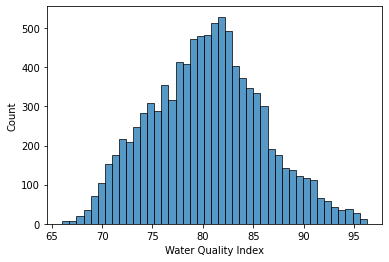

In [ ]:
sns.histplot(data['Water Quality Index'])

In [ ]:
# droping Unwanted features
wanted = ['Temperature (°C) ', 'pH', 'Turbidity (NTU)', 'Conductivity (μS/cm)', 'TDS (ppm)', 'Salinity (ppt)', 'Chloride (ppm)','DO (mg/L)','Ammonia (ppm)','Water Quality Index' ]
data = data[wanted]

In [ ]:
print(data.shape)
data.head()

(9623, 10)


,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Water Quality Index
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,81.053028
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,80.409816
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,81.355285
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,80.610194
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,79.187902


In [ ]:
data = data.drop_duplicates()

In [ ]:
print(data.shape)
data.head()

(9623, 10)


,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Water Quality Index
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,81.053028
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,80.409816
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,81.355285
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,80.610194
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,79.187902


# Multiple Linear Regression
-  it is important to check correlation before developing the regression model. If two independent variables are too highly correlated (r2 > ~0.6), then only one of them should be used in the regression model.
- The data should follow a normal distribution.


In [ ]:
data.head()

,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Water Quality Index
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,81.053028
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,80.409816
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,81.355285
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,80.610194
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,79.187902


In [ ]:
# Independent and Dependent Variables
df = data.copy()
df['Date'] = sd['Date']
df['Date'] = df['Date'].apply(lambda x: int(x.split('-')[2]))
x = df.drop('Water Quality Index',axis=1)
y = df[['Water Quality Index', 'Date']] 

In [ ]:
x.head()

,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Date
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,15
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,15
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,15
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,15
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,15


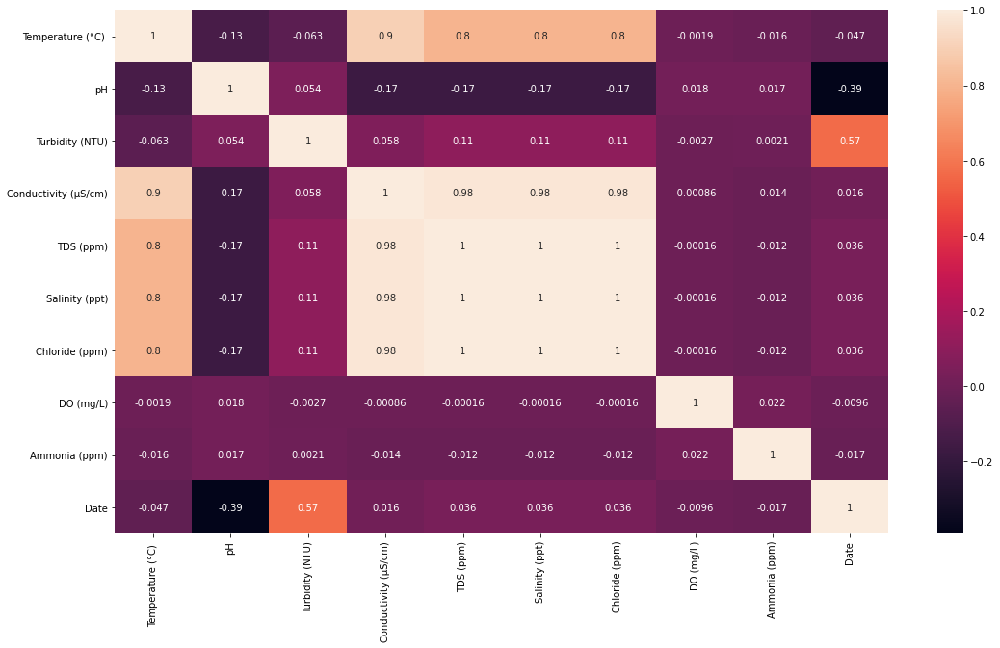

In [ ]:
plt.figure(figsize=(18,10))
sns.heatmap(x.corr(), annot=True,)

In [ ]:
x = x.drop(['Temperature (°C) ','TDS (ppm)'	,'Salinity (ppt)'	,'Chloride (ppm)'],axis=1)

In [ ]:
x.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm),Date
0,7.81,6.981818,799.33,7.27,0.389,15
1,7.81,6.981818,782.31,6.63,0.396,15
2,7.81,6.981818,816.16,7.49,0.377,15
3,7.81,6.981818,816.16,7.23,0.366,15
4,7.81,6.981818,816.16,6.69,0.345,15


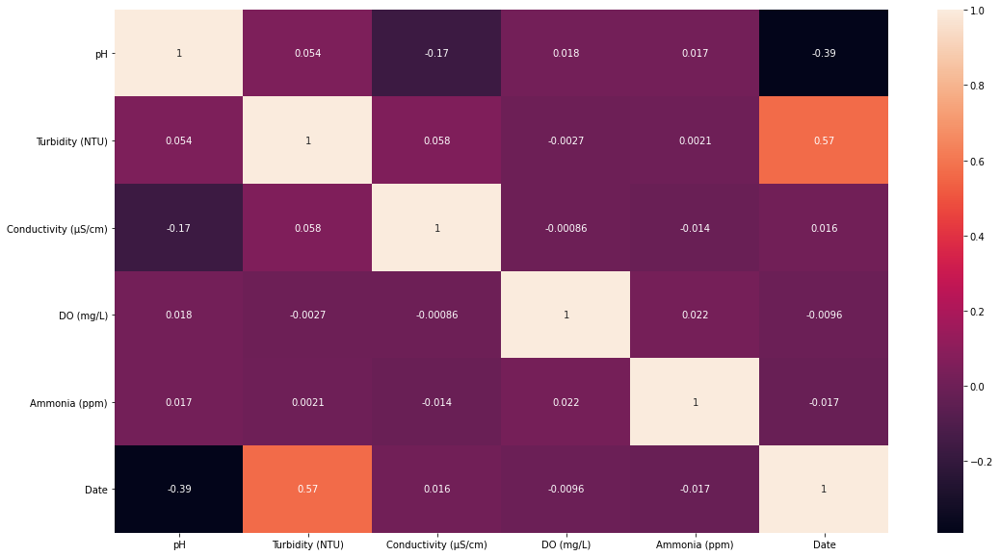

In [ ]:
plt.figure(figsize=(18,10))
sns.heatmap(x.corr(), annot=True)

In [ ]:
y.head()

,Water Quality Index,Date
0,81.053028,15
1,80.409816,15
2,81.355285,15
3,80.610194,15
4,79.187902,15


In [ ]:
# Train Test split based on days
x_train, y_train = x[x['Date'] <= 19], y[y['Date'] <= 19]
x_test, y_test = x[x['Date'] > 19], y[y['Date'] > 19]

In [ ]:
x_train, x_test, y_train, y_test = x_train.drop('Date',axis=1), x_test.drop('Date',axis=1), y_train.drop('Date',axis=1), y_test.drop('Date',axis=1)

In [ ]:
print(x_train.shape, x_test.shape,y_train.shape,y_test.shape) 

(6228, 5) (3395, 5) (6228, 1) (3395, 1)


In [ ]:
x_train.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,7.81,6.981818,799.33,7.27,0.389
1,7.81,6.981818,782.31,6.63,0.396
2,7.81,6.981818,816.16,7.49,0.377
3,7.81,6.981818,816.16,7.23,0.366
4,7.81,6.981818,816.16,6.69,0.345


In [ ]:
y_train.head()

,Water Quality Index
0,81.053028
1,80.409816
2,81.355285
3,80.610194
4,79.187902


In [ ]:
# Normalization
import sklearn
from sklearn.preprocessing import MinMaxScaler
normal = MinMaxScaler()

In [ ]:
x_train = pd.DataFrame(normal.fit_transform(x_train), columns=x_train.columns)
x_test = pd.DataFrame(normal.transform(x_test), columns=x_test.columns)

In [ ]:
x_train.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,0.572414,0.09375,0.703439,0.550725,0.886364
1,0.572414,0.09375,0.639180,0.086957,0.965909
2,0.572414,0.09375,0.766982,0.710145,0.750000
3,0.572414,0.09375,0.766982,0.521739,0.625000
4,0.572414,0.09375,0.766982,0.130435,0.386364


In [ ]:
x_test.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,0.006897,1.0,0.464920,0.688406,0.511364
1,0.006897,1.0,0.464920,0.956522,0.295455
2,0.013793,1.0,0.462372,0.797101,0.647727
3,0.013793,1.0,0.461522,0.775362,0.727273
4,0.013793,1.0,0.479362,0.050725,0.761364


In [ ]:
from sklearn.linear_model import LinearRegression
linear = LinearRegression()
linear.fit(x_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
y_pred = linear.predict(x_test)

In [ ]:
from sklearn import metrics
RMSE = np.sqrt(metrics.mean_squared_error(y_test,y_pred))
print("MSE : {}".format(metrics.mean_squared_error(y_test,y_pred)))
print("MAE : {}".format(metrics.mean_absolute_error(y_test,y_pred)))
print("RMSE : {}".format(RMSE))
print("R2 : {}".format(metrics.r2_score(y_test,y_pred)))

MSE : 1.509563401055289
MAE : 1.0042539291833736
RMSE : 1.2286429103101066
R2 : 0.9562571234399568


In [ ]:
linear.score(x_train,y_train), linear.score(x_test,y_test)

(0.9859598631452716, 0.9562571234399568)

In [ ]:
y_test = y_test.values.reshape((y_test.shape[0]))
y_pred = y_pred.reshape((y_test.shape[0]))

In [ ]:
diff = pd.DataFrame({'y_test': y_test,'y_pred': y_pred,'diff': y_test - y_pred},index=range(len(y_test)))
print(diff.shape)
diff.head()

(3395, 3)


,y_test,y_pred,diff
0,81.427809,79.837706,1.590103
1,80.137941,78.550352,1.587589
2,82.228892,80.642568,1.586324
3,82.695223,81.106720,1.588503
4,83.235221,81.545273,1.689948


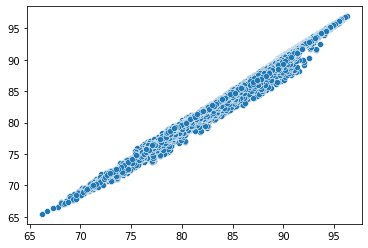

In [ ]:
sns.scatterplot(y_test,y_pred)

# Principle Componenet Regresssion 
- Performing Regression analysis after creating Principle Components is called PCR
- Before Using PCA we need to perfrom Standardization on our data
- we want the explained variance to be between 95–99%


In [ ]:
data.head()

,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Water Quality Index
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,81.053028
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,80.409816
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,81.355285
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,80.610194
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,79.187902


In [ ]:
# Independent and dependent variables
x = data.iloc[:,:-1]
y = data['Water Quality Index']

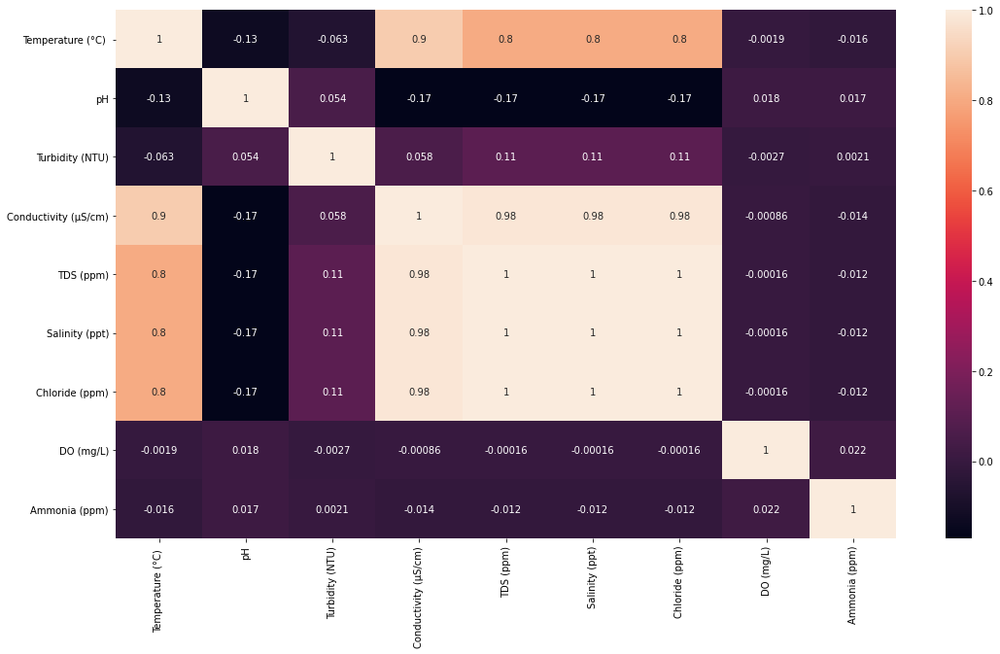

In [ ]:
plt.figure(figsize=(18,10))
sns.heatmap(x.corr(), annot=True)

In [ ]:
x = x.drop(['Temperature (°C) ','TDS (ppm)'	,'Salinity (ppt)'	,'Chloride (ppm)'],axis=1)

In [ ]:
x.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,7.81,6.981818,799.33,7.27,0.389
1,7.81,6.981818,782.31,6.63,0.396
2,7.81,6.981818,816.16,7.49,0.377
3,7.81,6.981818,816.16,7.23,0.366
4,7.81,6.981818,816.16,6.69,0.345


In [ ]:
x.shape, y.shape

((9623, 5), (9623,))

In [ ]:
# Standardization
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_s = scaler.fit_transform(x)

In [ ]:
x_s.shape

(9623, 5)

In [ ]:
# Principle Component Analysis with 95% explained variance
from sklearn.decomposition import PCA
pca = PCA(n_components = 0.95)
x_pc = pca.fit_transform(x_s)

In [ ]:
# Reduced to 5 features
x_pc.shape

(9623, 5)

In [ ]:
x_pc = pd.DataFrame(x_pc, columns=['V1','V2','V3','V4','V5'])
print(x_pc.shape)
x_pc.head()

(9623, 5)


,V1,V2,V3,V4,V5
0,-0.153683,-0.546607,-1.275994,0.820260,-0.911275
1,-0.094089,-0.846205,-0.317719,2.106911,-0.846869
2,-0.333504,-0.468389,-1.379627,0.110779,-1.035845
3,-0.450219,-0.660986,-0.655308,0.248656,-1.073614
4,-0.683025,-1.047913,0.803418,0.586258,-1.152194


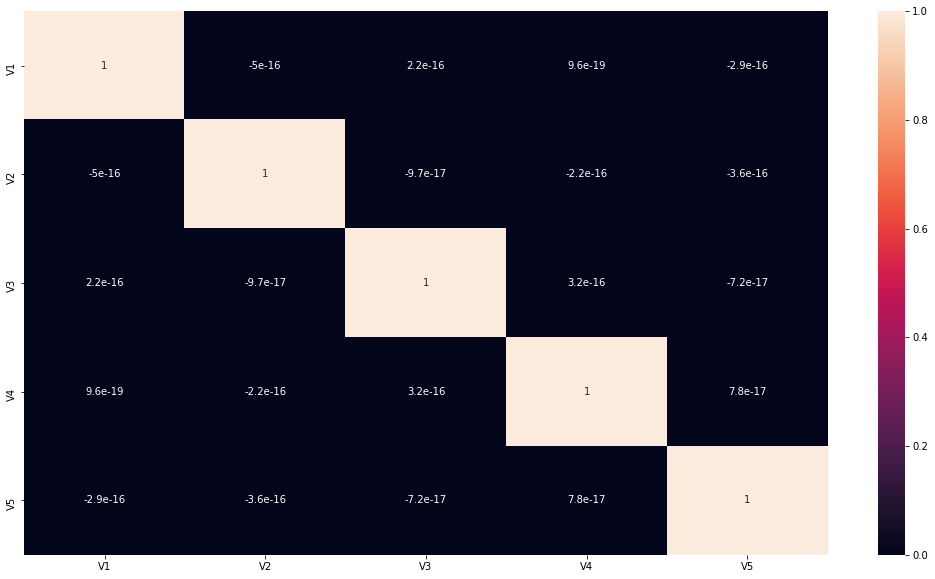

In [ ]:
plt.figure(figsize=(18,10))
sns.heatmap(x_pc.corr(), annot=True,)

In [ ]:
# PC data
df = pd.concat([sd['Date'].apply(lambda x: int(x.split('-')[2])), x_pc, y],axis=1)

In [ ]:
print(df.shape)
df.head()

(9623, 7)


,Date,V1,V2,V3,V4,V5,Water Quality Index
0,15,-0.153683,-0.546607,-1.275994,0.820260,-0.911275,81.053028
1,15,-0.094089,-0.846205,-0.317719,2.106911,-0.846869,80.409816
2,15,-0.333504,-0.468389,-1.379627,0.110779,-1.035845,81.355285
3,15,-0.450219,-0.660986,-0.655308,0.248656,-1.073614,80.610194
4,15,-0.683025,-1.047913,0.803418,0.586258,-1.152194,79.187902


In [ ]:
# Independent and dependent variables
x = df.iloc[:,:-1]
y = df[['Date','Water Quality Index']]

In [ ]:
x.head()

,Date,V1,V2,V3,V4,V5
0,15,-0.153683,-0.546607,-1.275994,0.820260,-0.911275
1,15,-0.094089,-0.846205,-0.317719,2.106911,-0.846869
2,15,-0.333504,-0.468389,-1.379627,0.110779,-1.035845
3,15,-0.450219,-0.660986,-0.655308,0.248656,-1.073614
4,15,-0.683025,-1.047913,0.803418,0.586258,-1.152194


In [ ]:
# Train Test split based on date
x_train, y_train = x[x['Date'] <= 19], y[y['Date'] <= 19]
x_test, y_test = x[x['Date'] > 19], y[y['Date'] > 19]

In [ ]:
x_train = x_train.drop('Date',axis=1)
x_test = x_test.drop('Date',axis=1)
y_train = y_train.drop('Date',axis=1)
y_test = y_test.drop('Date',axis=1)

In [ ]:
print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

(6228, 5) (6228, 1) (3395, 5) (3395, 1)


In [ ]:
# Performing Linear Regression
from sklearn.linear_model import LinearRegression
linear = LinearRegression()
linear.fit(x_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
y_pred = linear.predict(x_test)

In [ ]:
from sklearn import metrics
RMSE = np.sqrt(metrics.mean_squared_error(y_test,y_pred))
print("MSE : {}".format(metrics.mean_squared_error(y_test,y_pred)))
print("MAE : {}".format(metrics.mean_absolute_error(y_test,y_pred)))
print("RMSE : {}".format(RMSE))
print("R2 : {}".format(metrics.r2_score(y_test,y_pred)))

MSE : 1.509563401055296
MAE : 1.004253929183376
RMSE : 1.2286429103101095
R2 : 0.9562571234399566


In [ ]:
import warnings
warnings.filterwarnings('ignore')
linear.score(x_train,y_train), linear.score(x_test,y_test)

(0.9859598631452716, 0.9562571234399566)

In [ ]:
y_test.head()

,Water Quality Index
6228,81.427809
6229,80.137941
6230,82.228892
6231,82.695223
6232,83.235221


In [ ]:
y_test = y_test.values.reshape(y_test.shape[0])
y_pred = y_pred.reshape(y_test.shape[0])

In [ ]:
diff = pd.DataFrame({'y_test': y_test,'y_pred': y_pred,'diff': y_test - y_pred},index=range(len(y_test)))
print(diff.shape)
diff.head()

(3395, 3)


,y_test,y_pred,diff
0,81.427809,79.837706,1.590103
1,80.137941,78.550352,1.587589
2,82.228892,80.642568,1.586324
3,82.695223,81.106720,1.588503
4,83.235221,81.545273,1.689948


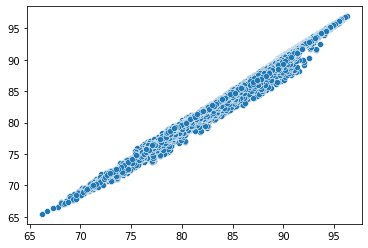

In [ ]:
sns.scatterplot(y_test,y_pred,)

# Partial Least Squares Regression
- The linear transformation in PCR is such that it minimises the covariance between the diffrent rows of  𝑋′ 
- PLS is based on finding a similar linear transformation, but accomplishes the same task by maximising the covariance between  𝑌  and  𝑋′

In [ ]:
from sklearn.cross_decomposition import PLSRegression
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
def optimise_pls_cv(X, y, n_comp):
    # Define PLS object
    pls = PLSRegression(n_components=n_comp)

    # Cross-validation
    y_cv = cross_val_predict(pls, X, y, cv=10)

    # Calculate scores
    r2 = r2_score(y, y_cv)
    mse = mean_squared_error(y, y_cv)
    
    return (y_cv, r2, mse)

In [ ]:
data.head()

,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Water Quality Index
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,81.053028
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,80.409816
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,81.355285
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,80.610194
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,79.187902


In [ ]:
# Independent and Dependent Variables
df = data.copy()
x = df.iloc[:,:-1]
y = df['Water Quality Index']

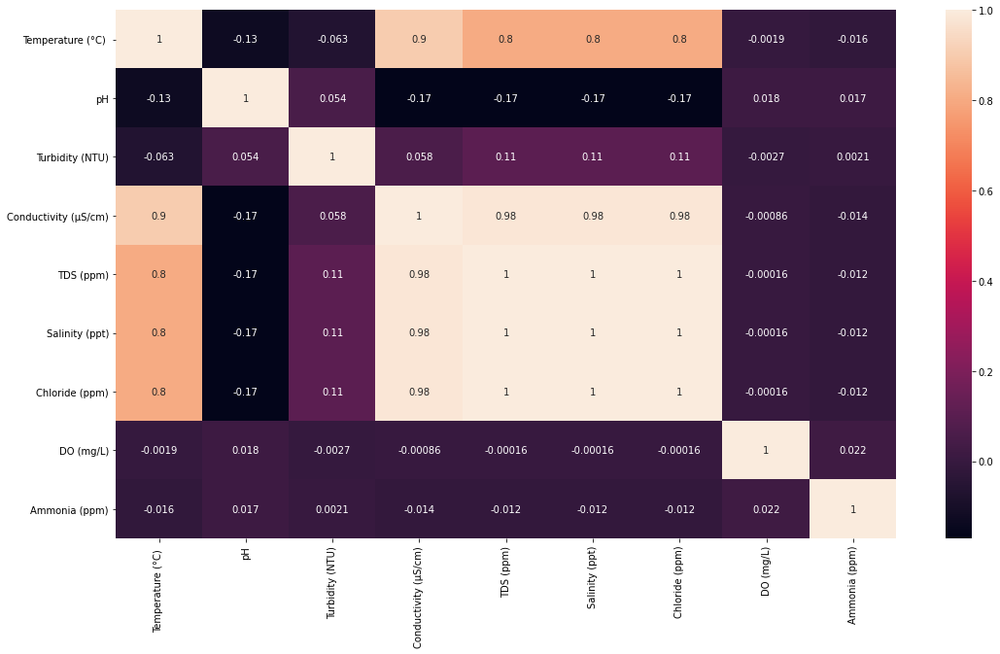

In [ ]:
plt.figure(figsize=(18,10))
sns.heatmap(x.corr(), annot=True,)

In [ ]:
x = x.drop(['Temperature (°C) ','TDS (ppm)'	,'Salinity (ppt)'	,'Chloride (ppm)'],axis=1)

In [ ]:
x.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,7.81,6.981818,799.33,7.27,0.389
1,7.81,6.981818,782.31,6.63,0.396
2,7.81,6.981818,816.16,7.49,0.377
3,7.81,6.981818,816.16,7.23,0.366
4,7.81,6.981818,816.16,6.69,0.345


In [ ]:
x.shape, y.shape

((9623, 5), (9623,))

In [ ]:
# Standardization
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_s = scaler.fit_transform(x)

In [ ]:
x_s.shape

(9623, 5)

In [ ]:
# test with 10 components
r2s = []
mses = []
xticks = np.arange(1, 5)
for n_comp in xticks:
    y_cv, r2, mse = optimise_pls_cv(x_s, y, n_comp)
    r2s.append(r2)
    mses.append(mse)

In [ ]:
# Plot the mses
def plot_metrics(vals, ylabel):
    with plt.style.context('ggplot'):

      plt.plot(xticks, np.array(vals), '-', color='blue', mfc='blue')
      idx = np.argmin(vals)
      plt.plot(xticks[idx], np.array(vals)[idx], 'P', ms=10)
      plt.xlabel('Number of PLS components')
      plt.xticks = xticks
      plt.ylabel(ylabel)
      plt.title('PLS')

    plt.show()

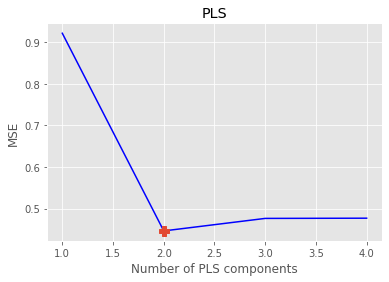

In [ ]:
plot_metrics(mses, 'MSE')

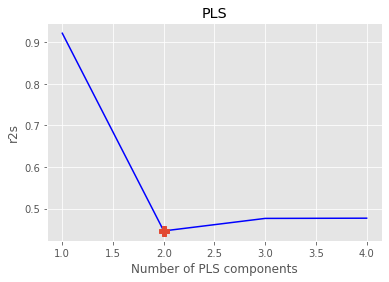

In [ ]:
plot_metrics(mses, 'r2s')

In [ ]:
x_s = pd.DataFrame(x_s, columns = x.columns)

In [ ]:
x_s.head()

,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,0.117485,-1.142575,0.643330,0.164941,1.301324
1,0.117485,-1.142575,0.400147,-1.428988,1.568666
2,0.117485,-1.142575,0.883799,0.712855,0.843024
3,0.117485,-1.142575,0.883799,0.065321,0.422915
4,0.117485,-1.142575,0.883799,-1.279557,-0.379111


In [ ]:
# PC data
df = pd.concat([sd['Date'].apply(lambda x: int(x.split('-')[2])), x_s, y],axis=1)

In [ ]:
# Independent and dependent variables
x = df.iloc[:,:-1]
y = df[['Date','Water Quality Index']]

In [ ]:
x.head()

,Date,pH,Turbidity (NTU),Conductivity (μS/cm),DO (mg/L),Ammonia (ppm)
0,15,0.117485,-1.142575,0.643330,0.164941,1.301324
1,15,0.117485,-1.142575,0.400147,-1.428988,1.568666
2,15,0.117485,-1.142575,0.883799,0.712855,0.843024
3,15,0.117485,-1.142575,0.883799,0.065321,0.422915
4,15,0.117485,-1.142575,0.883799,-1.279557,-0.379111


In [ ]:
# Train Test split based on date
x_train, y_train = x[x['Date'] <= 19], y[y['Date'] <= 19]
x_test, y_test = x[x['Date'] > 19], y[y['Date'] > 19]

In [ ]:
# Dropping Date Column
x_train = x_train.drop('Date',axis=1)
x_test = x_test.drop('Date',axis=1)
y_train = y_train.drop('Date',axis=1)
y_test = y_test.drop('Date',axis=1)

In [ ]:
pls = PLSRegression(n_components=xticks[np.argmin(mses)])
pls.fit(x_train, y_train)

PLSRegression(copy=True, max_iter=500, n_components=2, scale=True, tol=1e-06)

In [ ]:
y_pred = pls.predict(x_test)

In [ ]:
y_pred

array([[82.75731434],
       [81.35860399],
       [83.64994945],
       ...,
       [81.88054913],
       [79.34781738],
       [82.11895377]])

In [ ]:
from sklearn import metrics
RMSE = np.sqrt(metrics.mean_squared_error(y_test,y_pred))
print("MSE : {}".format(metrics.mean_squared_error(y_test,y_pred)))
print("MAE : {}".format(metrics.mean_absolute_error(y_test,y_pred)))
print("RMSE : {}".format(RMSE))
print("R2 : {}".format(metrics.r2_score(y_test,y_pred)))

MSE : 1.976866013919057
MAE : 1.2012474981895553
RMSE : 1.406010673472665
R2 : 0.942716015794928


In [ ]:
import warnings
warnings.filterwarnings('ignore')
pls.score(x_train,y_train), pls.score(x_test, y_test)

(0.9527868657411785, 0.942716015794928)

In [ ]:
y_test = y_test.values.reshape(y_test.shape[0])
y_pred = y_pred.reshape(y_test.shape[0])

In [ ]:
diff = pd.DataFrame({'y_test': y_test,'y_pred': y_pred,'diff': y_test - y_pred},index=range(len(y_test)))
print(diff.shape)
diff.head()

(3395, 3)


,y_test,y_pred,diff
0,81.427809,82.757314,-1.329505
1,80.137941,81.358604,-1.220663
2,82.228892,83.649949,-1.421057
3,82.695223,84.165389,-1.470166
4,83.235221,84.497066,-1.261845


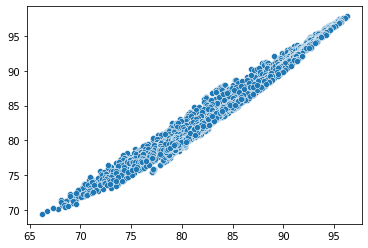

In [ ]:
sns.scatterplot(y_test,y_pred,)

# Results
### Salinity Not Dropped
- Got WQ in the range of 65 to 90 when turbidity is mapped to 6 to 24 NTU and Salinity Feature is present
- Correlation of WQ Parameters and WQI is less than 0.7 
- Got accuracy around 0.95 

### Salinity Dropped
- Got WQ in the range of 60 to 100 when turbidity is mapped to 6 to 24 NTU and Salinity Feature is dropped
- Correlation of Turbidity and WQI is  0.86
- Got accuracy around 0.99 

## Algorithms
- PCA  and MLR is working good with 95.6 % accuray compared to PLSR with 93.9%


In [ ]:
data.head()

,Temperature (°C),pH,Turbidity (NTU),Conductivity (μS/cm),TDS (ppm),Salinity (ppt),Chloride (ppm),DO (mg/L),Ammonia (ppm),Water Quality Index
0,20.99,7.81,6.981818,799.33,382.861933,0.255383,145.313035,7.27,0.389,81.053028
1,20.99,7.81,6.981818,782.31,374.709718,0.249462,141.943690,6.63,0.396,80.409816
2,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.49,0.377,81.355285
3,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,7.23,0.366,80.610194
4,20.98,7.81,6.981818,816.16,390.976248,0.261288,148.673134,6.69,0.345,79.187902
